In [2]:
pip install kaggle

     ---------------------------------------- 0.0/79.7 kB ? eta -:--:--
     ----- ---------------------------------- 10.2/79.7 kB ? eta -:--:--
     --------- ---------------------------- 20.5/79.7 kB 165.2 kB/s eta 0:00:01
     -------------- ----------------------- 30.7/79.7 kB 146.3 kB/s eta 0:00:01
     -------------------------------------- 79.7/79.7 kB 371.2 kB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Obtaining dependency information for certifi>=2023.7.22 from https://files.pythonhosted.org/packages/ba/06/a07f096c664aeb9f01624f858c3add0a4e913d6c96257acb4fce61e7de14/certifi-2024.2.2-py3-none-any.whl.metadata
  Using cached certifi-2024.2.2-py3-none-any.whl.metadata (2.2 kB)
  Obtaining dependency information for tqdm from https://files.pythonhosted.org/packages/18/eb/fdb7eb9e48b7b02554e1664afd3bd3f117f6b6d6c5881438a0b055554f9b/tqdm-4.66.4-py3-none-any.whl.metadata
     ----------------------------------


[notice] A new release of pip is available: 23.2.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


###### . #1.Retrieve dataset from the below source using an API call.

In [ ]:
kaggle datasets download -d rohitsahoo/sales-forecasting
# Command to download kaggel dataset from kaggle.
# Ran on cmd prompt not in jupyter notebook and python file.

###### 2. Perform data preprocessing tasks such as handling missing values, encoding categorical variables, and scaling numerical features.

In [13]:
pip install scikit-learn


[notice] A new release of pip is available: 23.2.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip



  Obtaining dependency information for scikit-learn from https://files.pythonhosted.org/packages/79/3d/02d5d3ed359498fec3abdf65407d3c07e3b8765af17464969055aaec5171/scikit_learn-1.4.2-cp311-cp311-win_amd64.whl.metadata
  Obtaining dependency information for scipy>=1.6.0 from https://files.pythonhosted.org/packages/d4/a1/d4adf25b6d2bef8d0ad1682829dcfcba97f3f96bb5b6f137bc3e41003cc7/scipy-1.13.0-cp311-cp311-win_amd64.whl.metadata
     ---------------------------------------- 0.0/60.6 kB ? eta -:--:--
     ---------------------------------------- 0.0/60.6 kB ? eta -:--:--
     ------ --------------------------------- 10.2/60.6 kB ? eta -:--:--
     ------------------- ------------------ 30.7/60.6 kB 330.3 kB/s eta 0:00:01
     ------------------- ------------------ 30.7/60.6 kB 330.3 kB/s eta 0:00:01
     ------------------- ------------------ 30.7/60.6 kB 330.3 kB/s eta 0:00:01
     ------------------- ------------------ 30.7/60.6 kB 330.3 kB/s eta 0:00:01
     ------------------- -------

In [14]:
import pandas as pd
from sklearn.preprocessing import LabelEncoder, StandardScaler

# Load the dataset
data = pd.read_csv("C:\\Users\\admin\\Downloads\\Data Engineer Assignmenr - FloData Analytics\\sales-forecasting\\train.csv")

# Handle missing values
data.fillna(0, inplace=True)  # Filling missing values with 0, you can use other strategies based on your data

# Encode categorical variables
label_encoders = {}
for col in data.select_dtypes(include=['object']).columns:
    label_encoders[col] = LabelEncoder()
    data[col] = label_encoders[col].fit_transform(data[col])

# Scale numerical features
scaler = StandardScaler()
data[data.select_dtypes(include=['float64', 'int64']).columns] = scaler.fit_transform(data.select_dtypes(include=['float64', 'int64']))


###### 3. Explore the dataset to understand its structure, distributions, and relationships between variables.

            Row ID   Postal Code         Sales
count  9800.000000   9800.000000   9800.000000
mean   4900.500000  55211.280918    230.769059
std    2829.160653  32076.677954    626.651875
min       1.000000      0.000000      0.444000
25%    2450.750000  23223.000000     17.248000
50%    4900.500000  57551.000000     54.490000
75%    7350.250000  90008.000000    210.605000
max    9800.000000  99301.000000  22638.480000


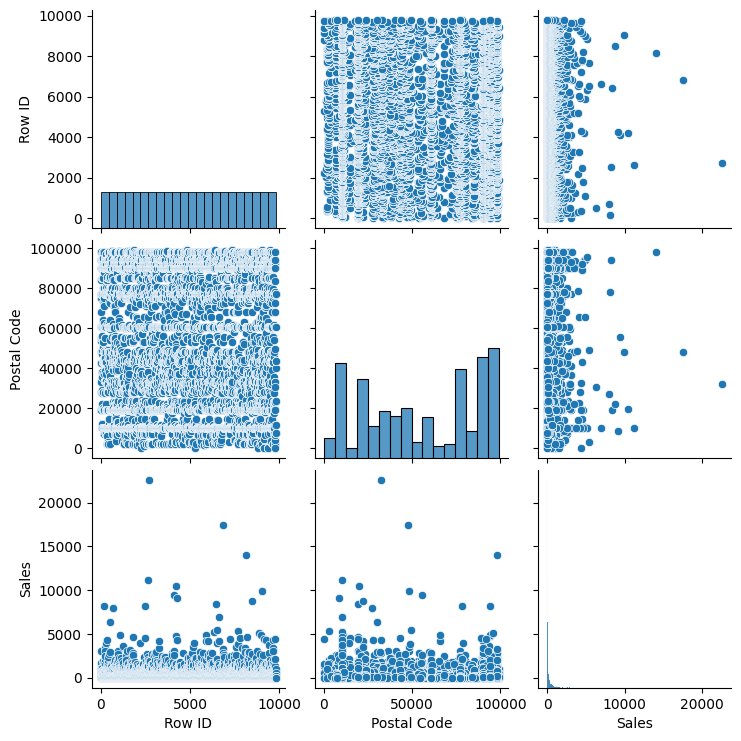

ValueError: could not convert string to float: 'CA-2017-152156'

In [7]:
# Summary statistics
print(data.describe())

# Visualizations
import seaborn as sns
import matplotlib.pyplot as plt

# Pairplot for understanding relationships between variables
sns.pairplot(data)
plt.show()

# Correlation matrix
corr_matrix = data.corr()
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.show()


###### 4. Showcase significant applications of lambda functions on the dataframe by providing examples.

In [ ]:
data['Order Date'] = pd.to_datetime(data['Order Date'], format="%d/%m/%Y")
data['Ship Date'] = pd.to_datetime(data['Ship Date'], format="%d/%m/%Y")
# Example 1: Applying a lambda function to create a new column based on existing columns
data['Duration'] = data.apply(lambda row: row['Ship Date'] - row['Order Date'], axis=1)

# Example: Filter rows where 'Sales' is greater than 1000
high_sales = data.loc[lambda x: x['Sales'] > 1000]  

###### Task 2: Exploratory Data Analysis (EDA)
1. Conduct exploratory data analysis to uncover insights and patterns in the dataset.

             Row ID     Order ID   Order Date    Ship Date    Ship Mode  \
count  9.800000e+03  9800.000000  9800.000000  9800.000000  9800.000000   
mean   4.640279e-17  2447.815612   606.047755   674.825714     2.236633   
std    1.000051e+00  1435.642030   353.619681   381.755738     1.099789   
min   -1.731874e+00     0.000000     0.000000     0.000000     0.000000   
25%   -8.659370e-01  1173.000000   302.000000   344.000000     2.000000   
50%    0.000000e+00  2449.000000   605.500000   679.000000     3.000000   
75%    8.659370e-01  3688.000000   912.000000  1015.000000     3.000000   
max    1.731874e+00  4921.000000  1229.000000  1325.000000     3.000000   

       Customer ID  Customer Name      Segment  Country         City  \
count  9800.000000    9800.000000  9800.000000   9800.0  9800.000000   
mean    400.946020     401.104898     0.657653      0.0   278.994388   
std     228.662431     228.372899     0.762582      0.0   138.425891   
min       0.000000       0.000000   

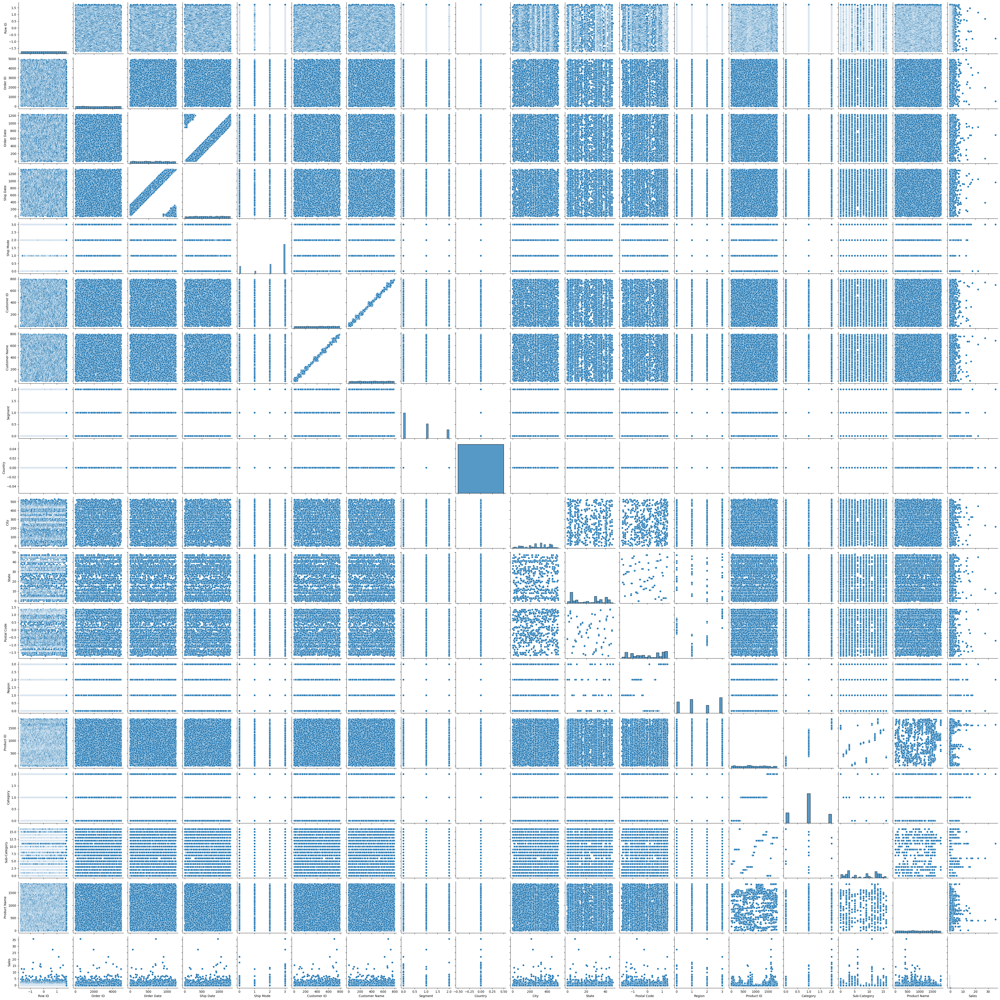

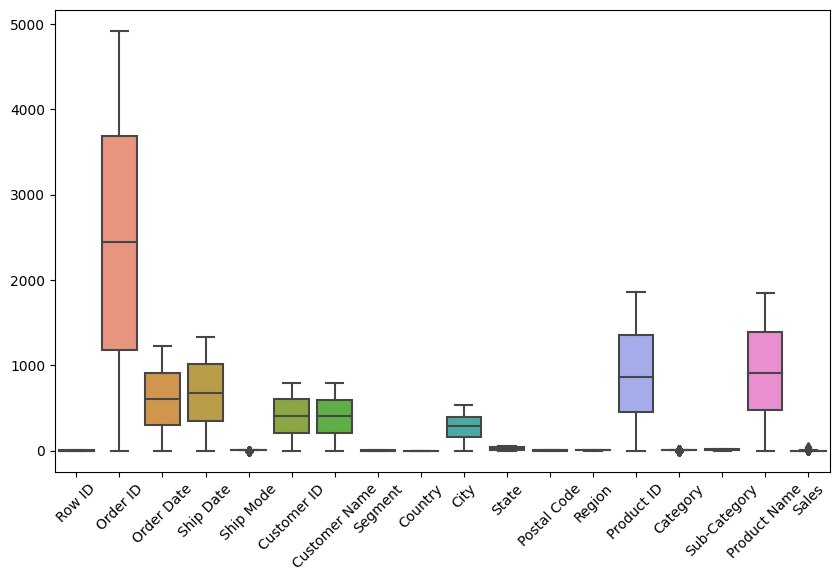

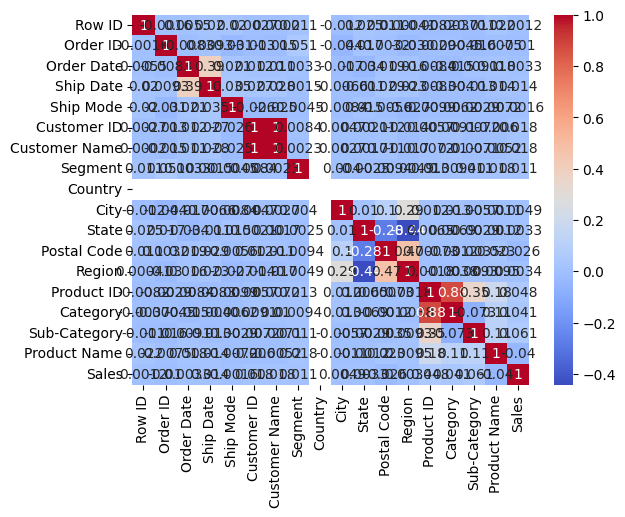

In [22]:
# Summary statistics
print(data.describe())

# Visualizations
import seaborn as sns
import matplotlib.pyplot as plt

# Pairplot for understanding relationships between numerical variables
sns.pairplot(data)
plt.show()

# Boxplot for visualizing distributions and detecting outliers
plt.figure(figsize=(10, 6))
sns.boxplot(data=data)
plt.xticks(rotation=45)
plt.show()

# Correlation matrix heatmap
corr_matrix = data.corr()
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.show()


###### 2. Visualize key relationships between variables using appropriate plots such as scatter plots, histograms, box plots, and heatmaps.

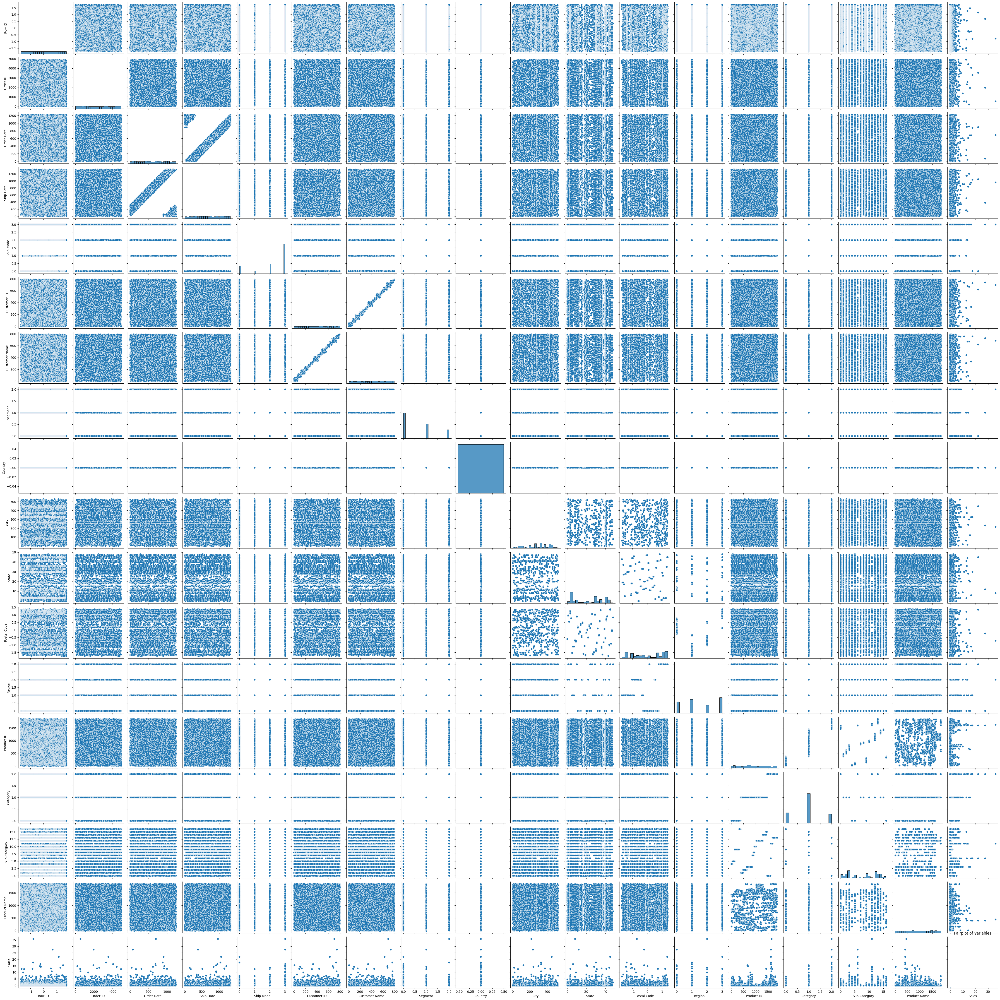

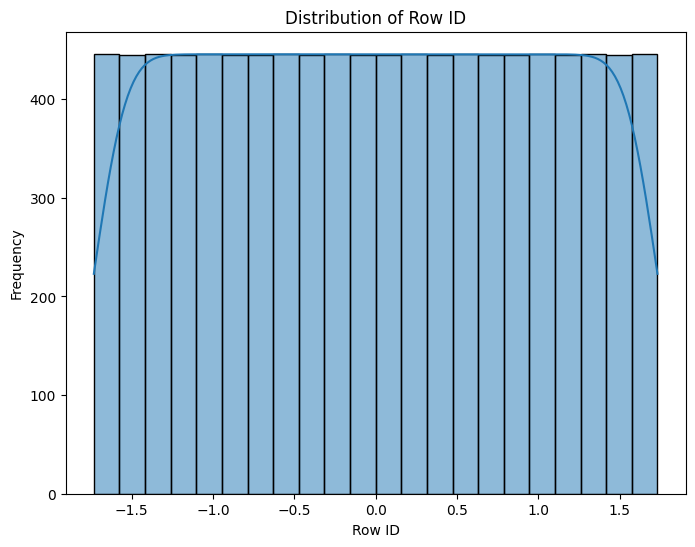

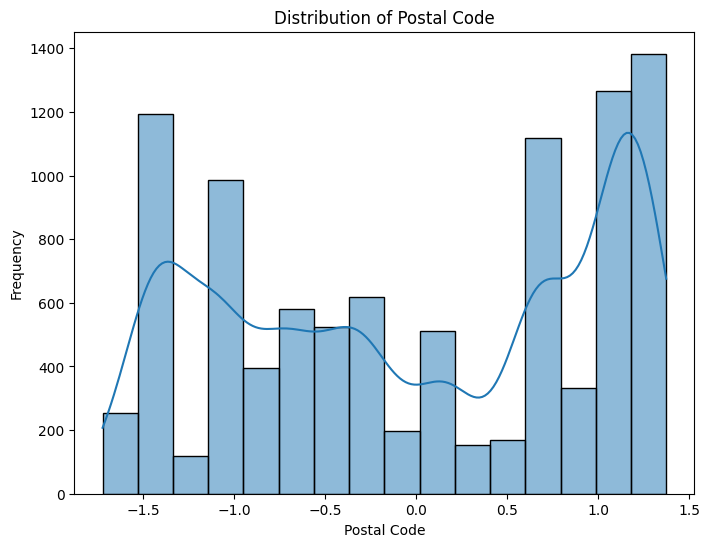

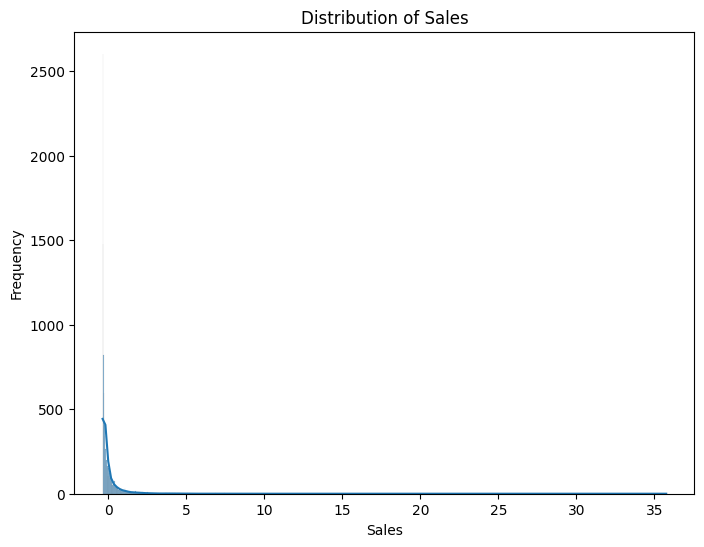

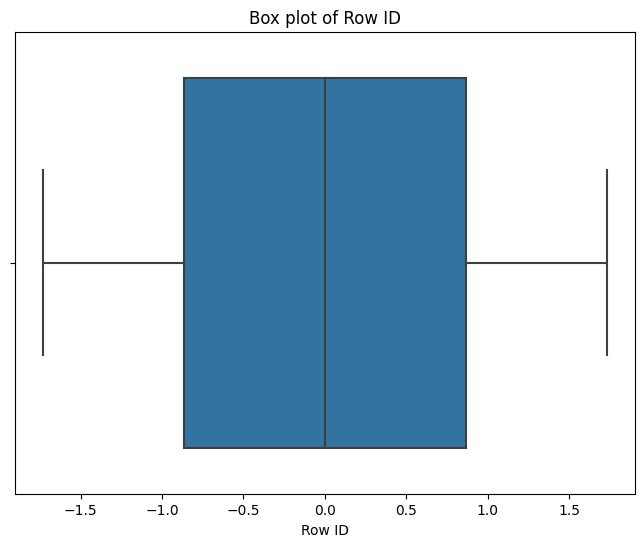

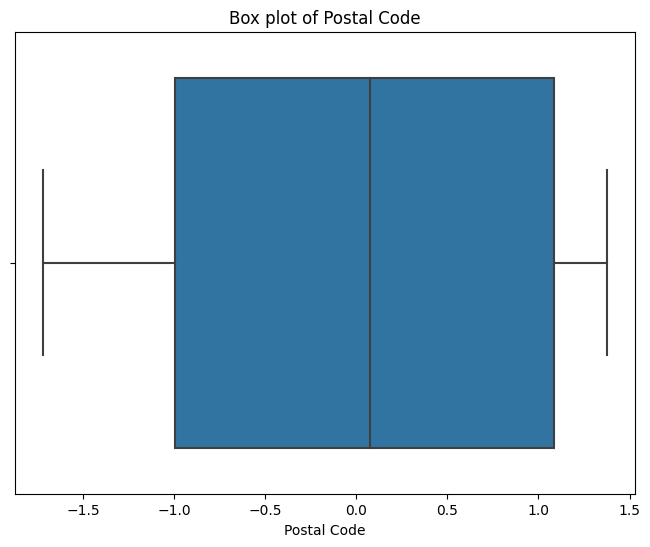

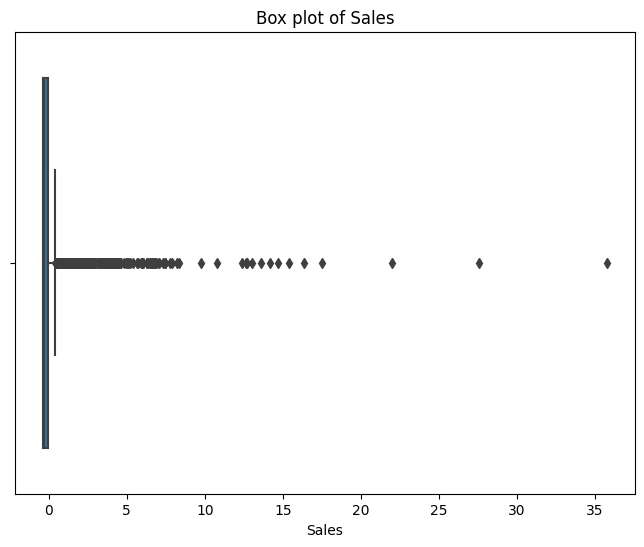

In [27]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Scatter plots for selected variables
sns.pairplot(data)
plt.title('Pairplot of Variables')
plt.show()

# Histograms for numerical variables
numerical_cols = data.select_dtypes(include=['int64', 'float64']).columns
for col in numerical_cols:
    plt.figure(figsize=(8, 6))
    sns.histplot(data[col], kde=True)
    plt.title(f'Distribution of {col}')
    plt.xlabel(col)
    plt.ylabel('Frequency')
    plt.show()

# Box plots for numerical variables
for col in numerical_cols:
    plt.figure(figsize=(8, 6))
    sns.boxplot(x=data[col])
    plt.title(f'Box plot of {col}')
    plt.xlabel(col)
    plt.show()


###### 3. Identify any outliers or anomalies and propose strategies for handling them.

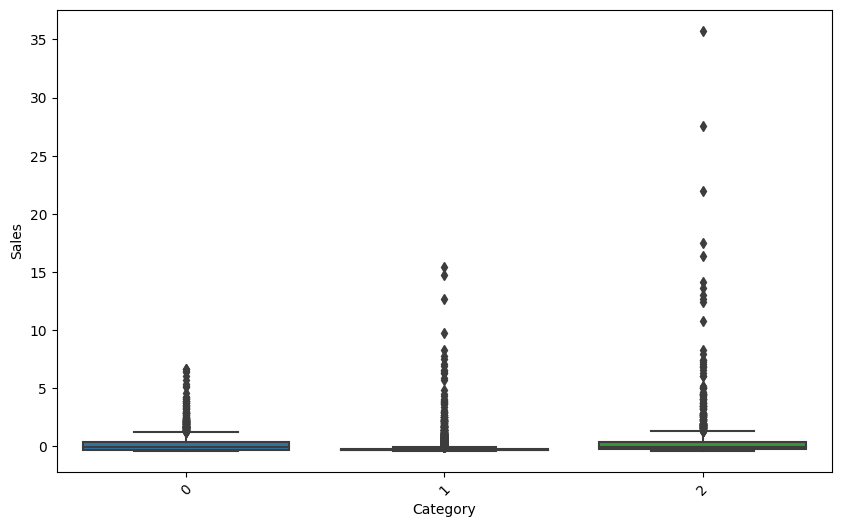

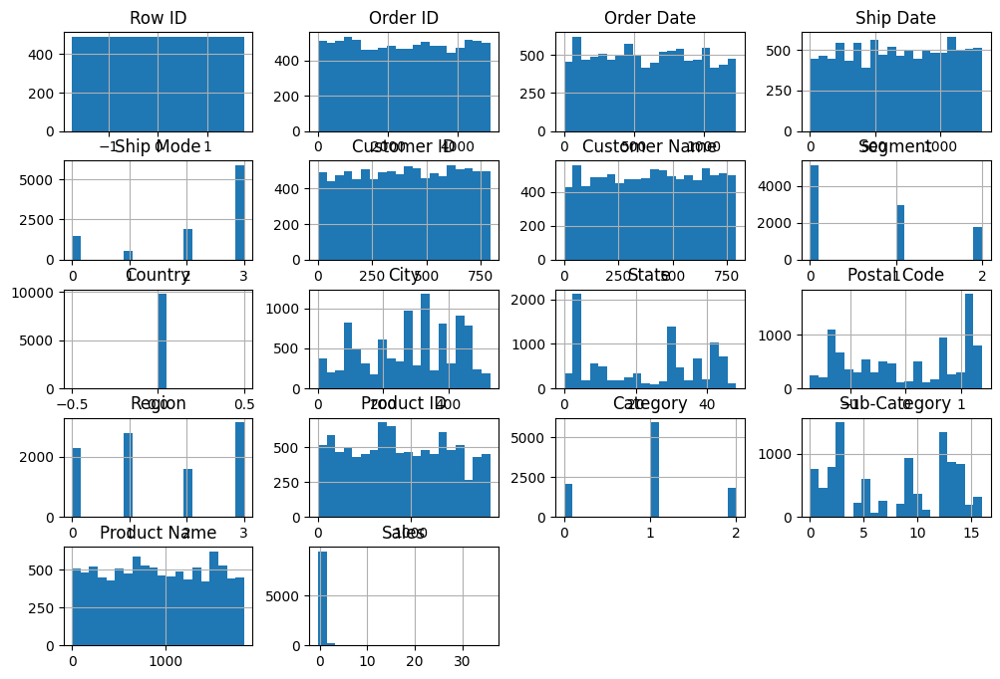

In [24]:
# Boxplot for detecting outliers in specific columns
plt.figure(figsize=(10, 6))
sns.boxplot(x='Category', y='Sales', data=data)
plt.xticks(rotation=45)
plt.show()

# Histograms for visualizing distributions
data.hist(figsize=(12, 8), bins=20)
plt.show()
